In [1]:

from PIL import Image
from pathlib import Path
from sklearn.manifold import TSNE
import pickle
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import pandas as pd
from collections import defaultdict
import plotly.graph_objects as go


Dataset agnostic code

In [21]:
def show_tsne_of_pathologies(collated_dataframe, layer, pathologies, find_optimal_perplexity = False, perplexity = 170, components=2, apply_pca_first = False, pca_components = 500):

    """
    layer options: 'patch_embeddings' 'post_layer_norm' 'q_former' 'language_projection'
    """

    embeddings = np.stack(collated_dataframe[layer].to_numpy(), axis=0)
    embeddings = np.reshape(embeddings, (embeddings.shape[0], -1))

    if apply_pca_first:
        pca = PCA(n_components=pca_components)
        embeddings = pca.fit_transform(embeddings)

    if not find_optimal_perplexity:
        optimal_perplexity = perplexity
        tsne_layer_embeddings = TSNE(n_components=components, perplexity=optimal_perplexity, n_iter=300).fit_transform(embeddings)
    else:

        perplexities = np.arange(10, 230, 20)
        divergences = []
        lowest_kl_divergence = float("inf")
        optimal_perplexity = None
        best_tsne = None
        for perplexity in perplexities:
            tsne = TSNE(n_components=components, perplexity=perplexity, n_iter=300)
            tsne.fit(embeddings)
            divergences.append(tsne.kl_divergence_)
            if tsne.kl_divergence_ < lowest_kl_divergence:
                lowest_kl_divergence = tsne.kl_divergence_
                optimal_perplexity = perplexity
                best_tsne = tsne
        
        plt.plot(perplexities, divergences)
        plt.title('KL divergence vs perplexity')
        plt.xlabel('Perplexity')
        plt.ylabel('KL divergence')
        plt.show()

        tsne_layer_embeddings = best_tsne.fit_transform(embeddings)

        
    # Create Plotly figure with scatter plot
    fig = go.Figure(data=go.Scatter(
        x=tsne_layer_embeddings[:,0], 
        y=tsne_layer_embeddings[:,1],
        mode='markers',
        marker=dict(color='lightgray')  # Default color
    ))

    # Add dropdown buttons and set up their functionality for interactive plotting
    buttons = []

    for pathology in pathologies:
        # Determine color for each point based on the pathology presence (True=blue, False=gray)
        colors = ['red' if val else 'lightgray' for val in collated_dataframe[pathology]]
        button = dict(label=pathology,
                    method='update',
                    args=[{'marker': {'color': colors, 'size': 5}}, 
                            {'title': f"t-SNE of {layer} embeddings colored by {pathology}"}])
        buttons.append(button)
    
    if apply_pca_first:
        title = f"t-SNE of PCA'd {layer} embeddings"
    else:
        title = f"t-SNE of {layer} embeddings"
    fig.update_layout(
        updatemenus=[
            dict(buttons=buttons,
                direction="down",
                pad={"r": 10, "t": 10},
                showactive=True,
                x=0.1,
                xanchor="left",
                y=1.15,
                yanchor="top")
        ],
        title=title,
        xaxis=dict(title='t-SNE Dimension 1'),
        yaxis=dict(title='t-SNE Dimension 2')
    )

    fig.show()   



In [5]:
def show_tsne_of_each_pathology_with_location(collated_dataframe, layer,pathologies, find_optimal_perplexity = False, perplexity = 10, components=2, apply_pca_first = False, pca_components = 1000):
    for pathology in pathologies:
        position_column = pathology + " position"

        # select the rows where the pathology is present
        filtered_df = collated_dataframe[collated_dataframe[pathology] == True]
        filtered_embeddings = np.stack(filtered_df[layer].to_numpy()).view(np.float32).reshape(filtered_df.shape[0], -1)

        if apply_pca_first:
            pca = PCA(n_components=pca_components)
            filtered_embeddings = pca.fit_transform(filtered_embeddings)
        
        filtered_tsne = TSNE(n_components=components, random_state=42, perplexity=perplexity, n_iter=300)
        filtered_tsne_result = filtered_tsne.fit_transform(filtered_embeddings)

        # create a plotly figure with scatter plot for the filtered and computed t-SNE results
        fig = go.Figure(
            data=go.Scatter(
                x=filtered_tsne_result[:, 0], 
                y=filtered_tsne_result[:, 1],
                mode='markers',

                marker=dict(color=['blue' if position == 'left' else 'red' if position == 'right' else 'green' if position == 'left and right' else 'gray' for position in filtered_df[position_column] ]),
                text=filtered_df['image_id']  # Assuming you may want to show the image_id as hover text
            )
        )

        # set up the layout and title to reflect the selected pathology and its position information
        fig.update_layout(
            title=f"t-SNE of {layer} embeddings colored by {pathology} position",
            xaxis=dict(title='t-SNE Dimension 1'),
            yaxis=dict(title='t-SNE Dimension 2'),
        )

        fig.show()



VinDR specific pathology detection

In [2]:
vindr_pathologies = ['Mediastinal shift', 'Consolidation',
       'Lung cyst', 'Cardiomegaly', 'Pleural thickening', 'Lung cavity',
       'Atelectasis', 'Lung Opacity', 'Emphysema', 'Nodule/Mass',
       'Calcification', 'Pneumothorax', 'Aortic enlargement', 'ILD',
       'Infiltration', 'Clavicle fracture', 'Rib fracture', 'No finding',
       'Pulmonary fibrosis', 'Other lesion', 'Pleural effusion', 'Enlarged PA']

vindr_pathologies_with_over_10 = ['Mediastinal shift', 'Consolidation','Cardiomegaly', 'Pleural thickening',
              'Atelectasis', 'Lung Opacity', 'Nodule/Mass', 'Calcification', 'Pneumothorax',
              'Aortic enlargement', 'ILD', 'Infiltration', 'Rib fracture', 'No finding',
              'Pulmonary fibrosis', 'Other lesion', 'Pleural effusion']

In [8]:
collated_all_test_pathologies = Path("/vol/biomedic3/bglocker/ugproj2324/nns20/CheXagent/model_inspection/embeddings/VinDr/no_tuning_4934e91451945c8218c267aae9c34929a7677829/collated_dataframe.pkl")
collated_all_test_pathologies = pickle.load(open(collated_all_test_pathologies, "rb"))


In [6]:
show_tsne_of_pathologies(collated_all_test_pathologies,'patch_embeddings',vindr_pathologies, apply_pca_first = False)

In [9]:

show_tsne_of_pathologies(collated_all_test_pathologies,'post_layer_norm',vindr_pathologies, apply_pca_first = True)

In [ ]:
show_tsne_of_pathologies(collated_all_test_pathologies,'q_former',vindr_pathologies, apply_pca_first = True)

In [10]:
show_tsne_of_pathologies(collated_all_test_pathologies,'language_projection',vindr_pathologies, apply_pca_first = True)

In [2]:
collated_train_pathologies_path = Path("/vol/biomedic3/bglocker/ugproj2324/nns20/CheXagent/model_inspection/embeddings/VinDr/no_tuning_4934e91451945c8218c267aae9c34929a7677829/collated_train_pathology_only.pkl")
collated_train_pathologies = pickle.load(open(collated_train_pathologies_path, "rb"))
# join together the train and test dataframes
collated_all_test_train_pathologies = pd.concat([collated_all_test_pathologies, collated_train_pathologies])

In [11]:
show_tsne_of_pathologies(collated_all_test_train_pathologies,'q_former',vindr_pathologies, apply_pca_first = True)

CheXpert test set

In [3]:
cheXpert_pathologies = ['No Finding','Enlarged Cardiomediastinum','Cardiomegaly','Lung Opacity',
        'Lung Lesion','Edema','Consolidation','Pneumonia','Atelectasis','Pneumothorax',
        'Pleural Effusion','Pleural Other','Fracture','Support Devices']

collated_all_test_pathologies_chexpert_path = Path("/vol/biomedic3/bglocker/ugproj2324/nns20/CheXagent/model_inspection/embeddings/CheXpert-small/collated_test_df.pkl")
collated_all_test_pathologies_chexpert = pickle.load(open(collated_all_test_pathologies_chexpert_path, "rb"))

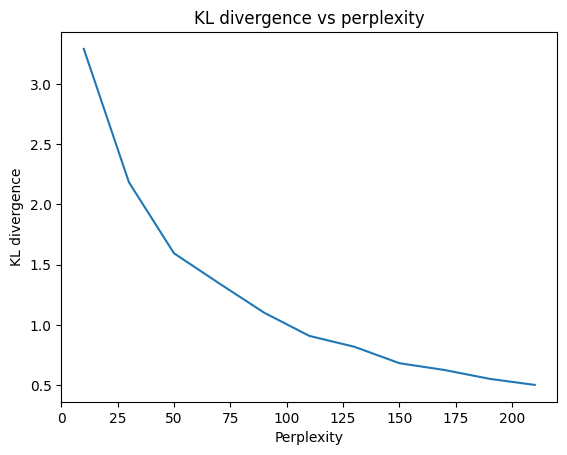

In [24]:
show_tsne_of_pathologies(collated_all_test_pathologies_chexpert,'patch_embeddings',cheXpert_pathologies, find_optimal_perplexity=True, apply_pca_first = True)

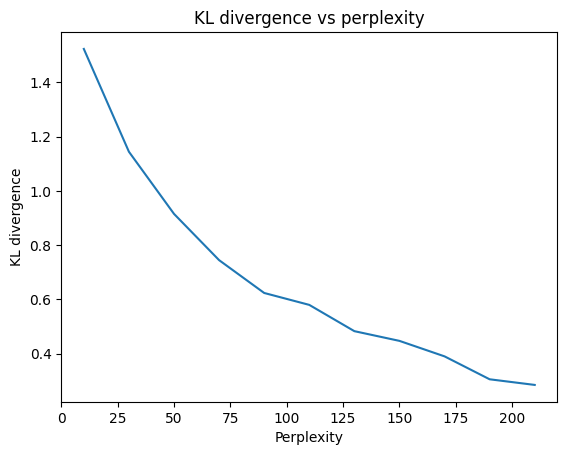

In [22]:
show_tsne_of_pathologies(collated_all_test_pathologies_chexpert,'post_layer_norm',cheXpert_pathologies, find_optimal_perplexity=True, apply_pca_first = True)

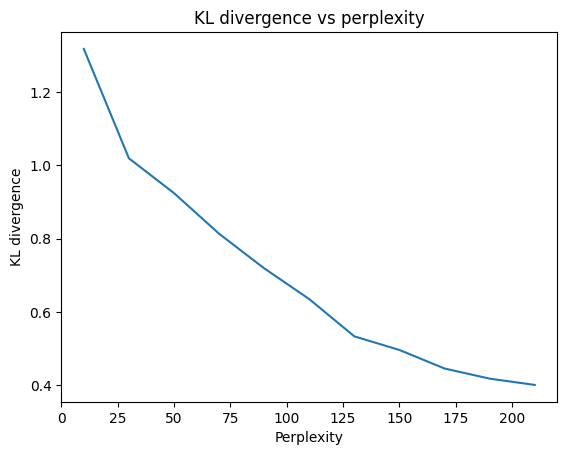

In [23]:
show_tsne_of_pathologies(collated_all_test_pathologies_chexpert,'q_former',cheXpert_pathologies, find_optimal_perplexity=True, apply_pca_first = True)

VINDR by location

In [8]:
show_tsne_of_each_pathology_with_location(collated_all_test_pathologies,'q_former', vindr_pathologies_with_over_10)